# Piecewise Linear Merge Tree Cophenetic Divergence


In [2]:
import os
import pickle
from trajectories import generate_trajectories
from plots_and_correlates import plot_lce_estimate_and_correlation
from lca_supervised_learning import score_classification
from lca_supervised_learning import score_regression
from lca_supervised_learning import score_regression_pos
from TimeSeriesMergeTreeSimple import TimeSeriesMergeTree as TSMT


In [3]:
SYS_NAMES = ["henon", "ikeda", "logistic", "tinkerbell"]
DIV_TYPES = ["dmt", "mt", "hvg", "ph"]
RES_TYPES = ["correlations", "divergences"]

In [4]:
SEED = 42
SAMPLES = 500
LENGTH = 1000
experimental_data = generate_trajectories(
    RANDOM_SEED=SEED, TS_LENGTH=LENGTH, CONTROL_PARAM_SAMPLES=SAMPLES
)

Experiment config -- SEED:42, LENGTH:1000, SAMPLES:500


In [5]:
logistic_trajectories = experimental_data["logistic"]["trajectories"]
logistic_lces = experimental_data["logistic"]["lces"]
logistic_control_params = experimental_data["logistic"]["sys_params"]

In [6]:
henon_trajectories = experimental_data["henon"]["trajectories"]
henon_lces = experimental_data["henon"]["lces"]
henon_control_params = experimental_data["henon"]["sys_params"]

In [7]:
ikeda_trajectories = experimental_data["ikeda"]["trajectories"]
ikeda_lces = experimental_data["ikeda"]["lces"]
ikeda_control_params = experimental_data["ikeda"]["sys_params"]

In [8]:
tinkerbell_trajectories = experimental_data["tinkerbell"]["trajectories"]
tinkerbell_lces = experimental_data["tinkerbell"]["lces"]
tinkerbell_control_params = experimental_data["tinkerbell"]["sys_params"]

In [9]:
system_data = {
    "logistic": {
        "trajectories": logistic_trajectories,
        "lces": logistic_lces,
        "control_params": logistic_control_params,
        "param_name": "r",
    },
    "henon": {
        "trajectories": henon_trajectories,
        "lces": henon_lces,
        "control_params": henon_control_params,
        "param_name": "a",
    },
    "ikeda": {
        "trajectories": ikeda_trajectories,
        "lces": ikeda_lces,
        "control_params": ikeda_control_params,
        "param_name": "a",
    },
    "tinkerbell": {
        "trajectories": tinkerbell_trajectories,
        "lces": tinkerbell_lces,
        "control_params": tinkerbell_control_params,
        "param_name": "a",
    },
}

## Build merge trees and compute divergences

In [12]:
def equalize_minima_maxima(ts):
    # forget intermediate non-critical points and equalize count of minima/maxima
    new_ts = [ts[0]]
    N = len(ts)
    for idx in range(1,N-1):
        x, y, z = ts[idx-1:idx+2]
        if ((x<=y) and (y<=z)) or ((x>=y) and (y>=z)):
            # monotonic subsequence
            continue
        new_ts.append(y)
    if (len(new_ts) % 2) == 1:
        new_ts.append(ts[-1])
    return new_ts


In [13]:
logistic_trajectories_adjusted = map(equalize_minima_maxima, logistic_trajectories)

In [30]:
tsmts = map(TSMT, logistic_trajectories_adjusted)

In [15]:
cophenetic_divs = map(lambda tsmt: tsmt.cophenetic_vector_divergence, tsmts)

In [17]:
list(cophenetic_divs)

[9.639707512638035,
 9.617882058991858,
 9.672728014164592,
 9.770433693820902,
 9.753996016611822,
 9.779054169280375,
 9.795155981917897,
 10.010957590683113,
 10.222484539494447,
 10.261560328048006,
 10.462055857982307,
 10.536258443113503,
 10.513925857128129,
 10.56200954501262,
 10.586055256248468,
 10.584854306625788,
 10.737928738979427,
 10.967578459681059,
 11.107744059795415,
 11.201241987662913,
 11.253338625177902,
 11.260907916512457,
 11.235551276535606,
 11.275508429231408,
 11.246443089076475,
 11.31770683025159,
 11.335822678611061,
 11.482133380449142,
 11.755288693219235,
 11.830915826368564,
 11.836698383448457,
 11.870208033199582,
 12.01298502807237,
 12.081300962435655,
 12.113313119722521,
 12.13699605823224,
 12.148742812481014,
 12.285929021366844,
 12.33055187142324,
 12.338149906338808,
 12.420677753017054,
 12.446765460964418,
 12.474468531089261,
 12.675131188867972,
 12.895167952945394,
 12.987985875922064,
 11.464068063981243,
 13.401729447882111,
 13.

In [18]:
result = _17

In [31]:
cophenetic_reverse_divs = list(map(lambda tsmt: tsmt.cophenetic_vector_divergence, tsmts))

In [28]:
cophenetic_reverse

In [29]:
list(cophenetic_reverse)

[]

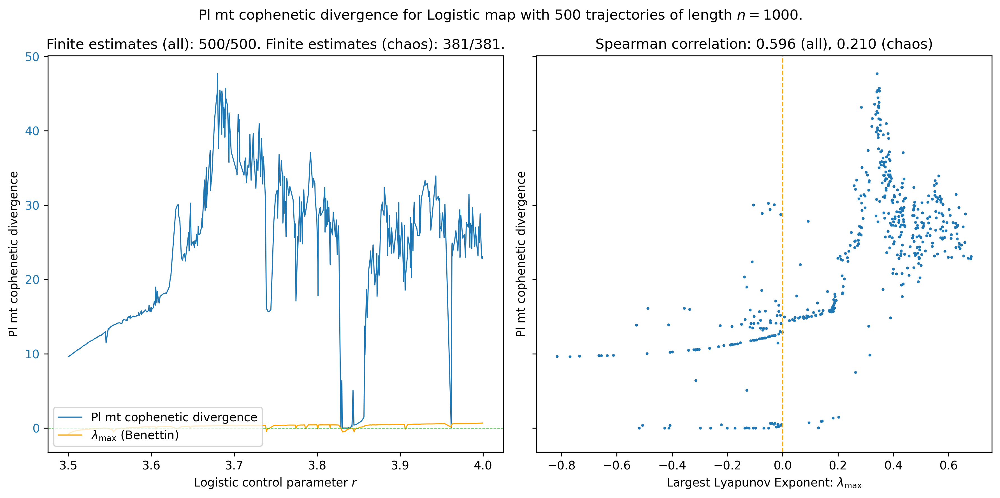

In [20]:
correlation_etc = plot_lce_estimate_and_correlation(
    "PL MT cophenetic divergence",
    "logistic",
    "r",
    result,
    logistic_lces,
    logistic_control_params,
    LENGTH,
    save_plot=False,
    plot_actual=True
)


In [23]:
cophenetic_reverse_divs

[]

In [22]:
correlation_etc = plot_lce_estimate_and_correlation(
    "PL MT cophenetic divergence",
    "logistic",
    "r",
    cophenetic_reverse_divs,
    logistic_lces,
    logistic_control_params,
    LENGTH,
    save_plot=False,
    plot_actual=True
)


IndexError: boolean index did not match indexed array along dimension 0; dimension is 0 but corresponding boolean dimension is 500

## Visualise divergences and get Spearman and supervised learning results

In [72]:
DIVS_TO_REPORT = [
    "cophenetic",
    "cophenetic_reverse",
    "bottleneck",
    "wasserstein"
]

MASKS = [0.1, 0.2, 0.3, 0.4, 0.5]
DIVS_TO_REPORT.extend([f"interleaving_{mask}_None" for mask in MASKS])
DIVS_TO_REPORT.extend([f"interleaving_edge_{mask}_None" for mask in MASKS])
DIVS_TO_REPORT.extend([f"interleaving_length_{mask}_None" for mask in MASKS])

def generate_correlations_and_scores_from_results_files(system_data, SYS_NAMES=SYS_NAMES, DIV_TYPES=DIV_TYPES):
    correlations_and_scores = {}
    res_type = "divergences"
    for sys_name in SYS_NAMES:
        sys_data = system_data[sys_name]
        param_name = sys_data["param_name"]
        lces_actual = sys_data["lces"]
        control_params = sys_data["control_params"]
        for div_type in DIV_TYPES:
            divergence_results = load_results_file(
                sys_name,
                div_type,
                res_type=res_type,
                seed=SEED,
                length=LENGTH,
                samples=SAMPLES,
            )
            divergence_data = divergence_results["data"]
            for div_name, divergences in divergence_data.items():
                if div_name not in DIVS_TO_REPORT:
                    continue
                div_name = f"{div_name} divergence"
                correlations_and_scores[
                    div_name, sys_name, LENGTH
                ] = plot_lce_estimate_and_correlation(
                    div_name,
                    sys_name,
                    param_name,
                    divergences,
                    lces_actual,
                    control_params,
                    LENGTH,
                    plot_actual=True,
                    save_plot=True,
                    sharey=False,
                    logy=False,
                    twoy=True
                )
                correlations_and_scores[
                    div_name, sys_name, LENGTH
                ] |= {
                    "classification_f1": score_classification(divergences.reshape(-1,1), lces_actual),
                    "regression_neg_mean_absolute": score_regression(divergences.reshape(-1,1), lces_actual),
                    "pos_regression_neg_mean_absolute": score_regression_pos(divergences.reshape(-1,1), lces_actual)
                }
    return correlations_and_scores


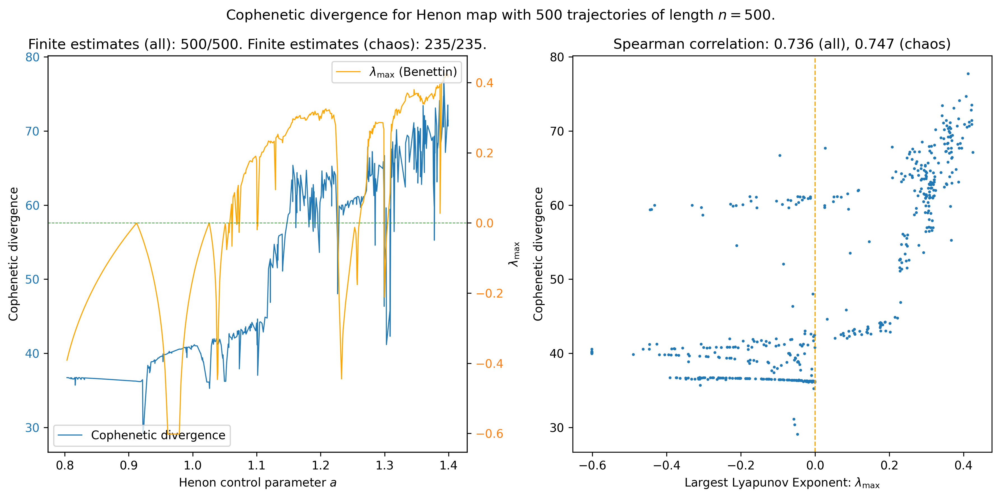

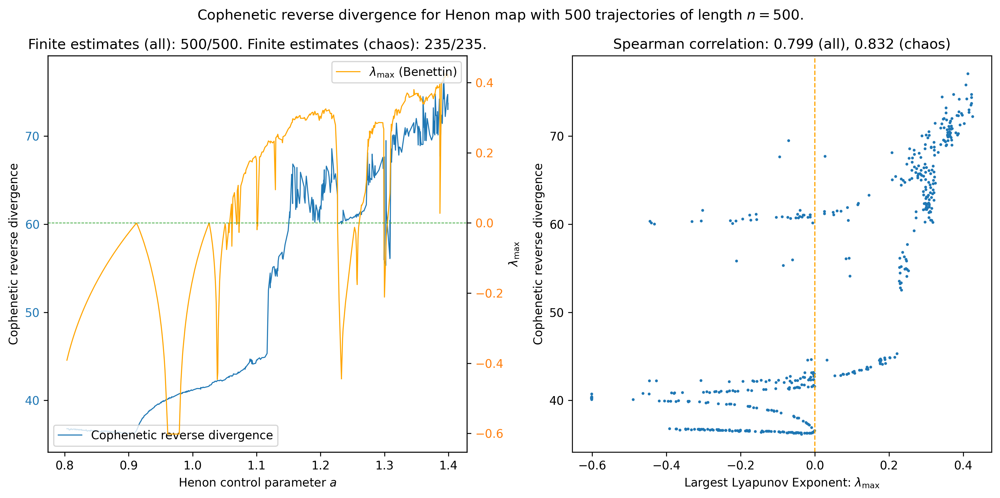

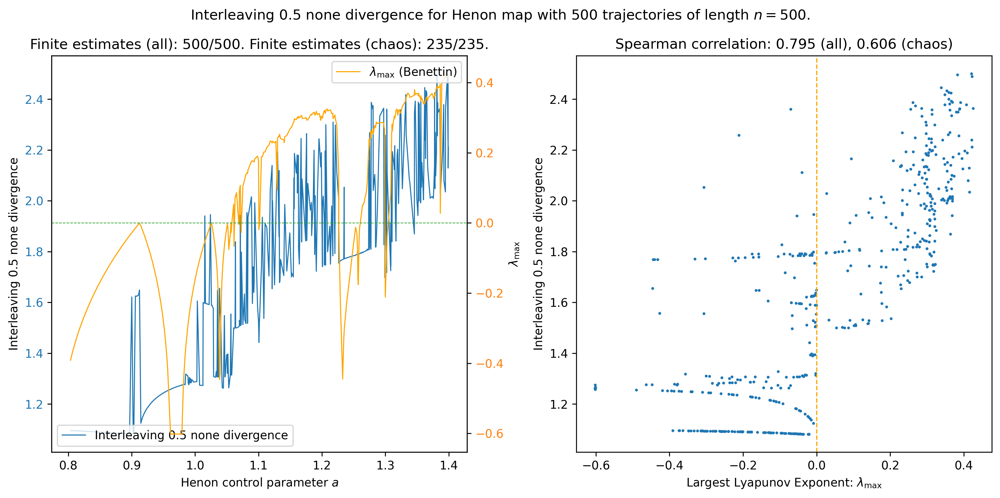

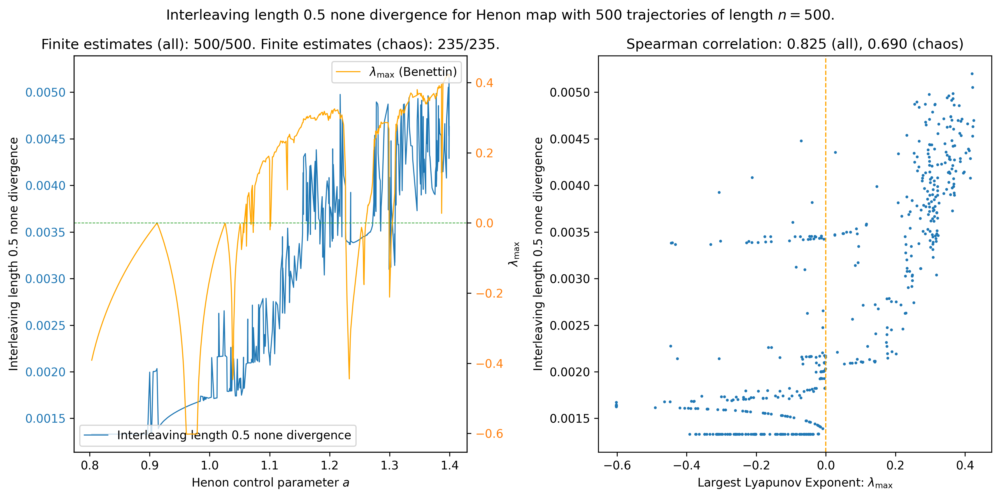

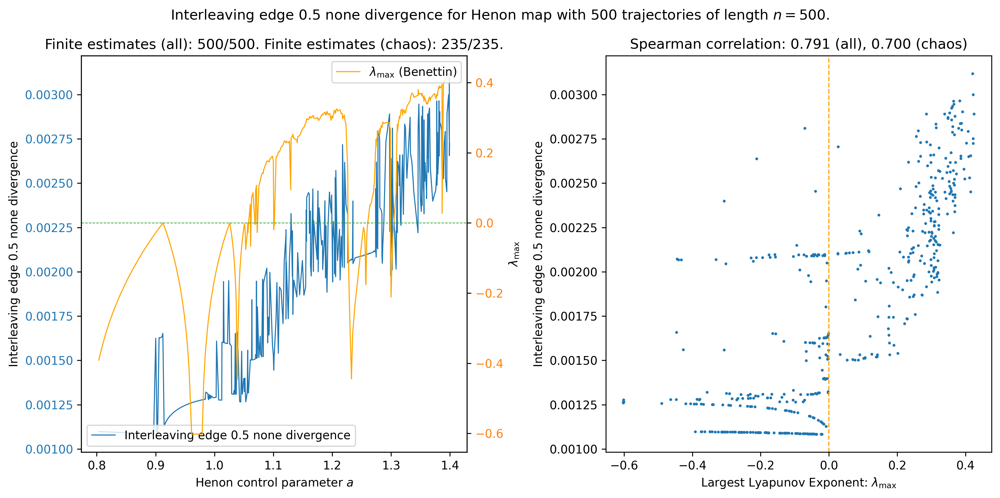

...

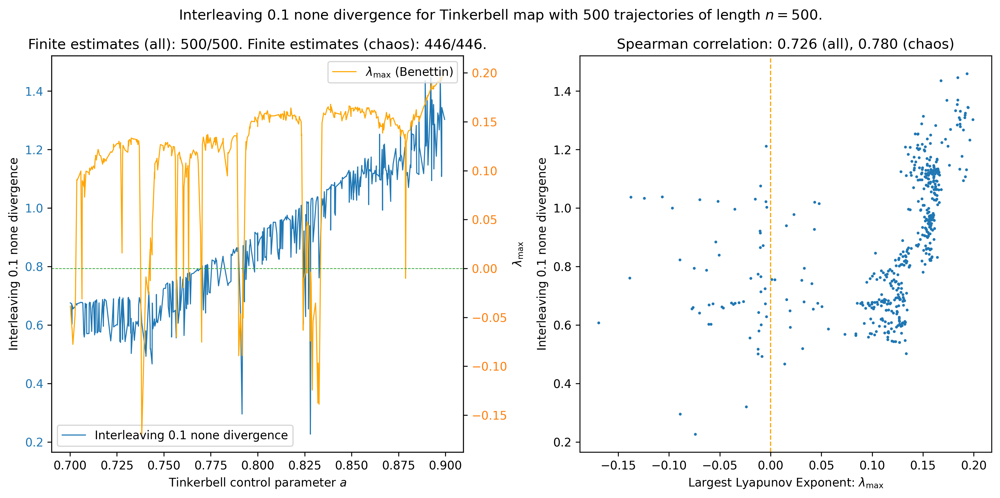

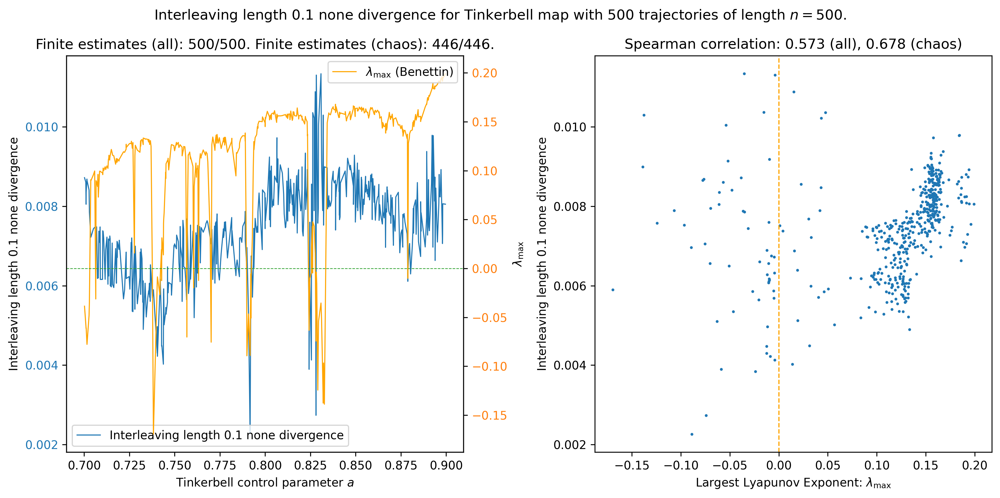

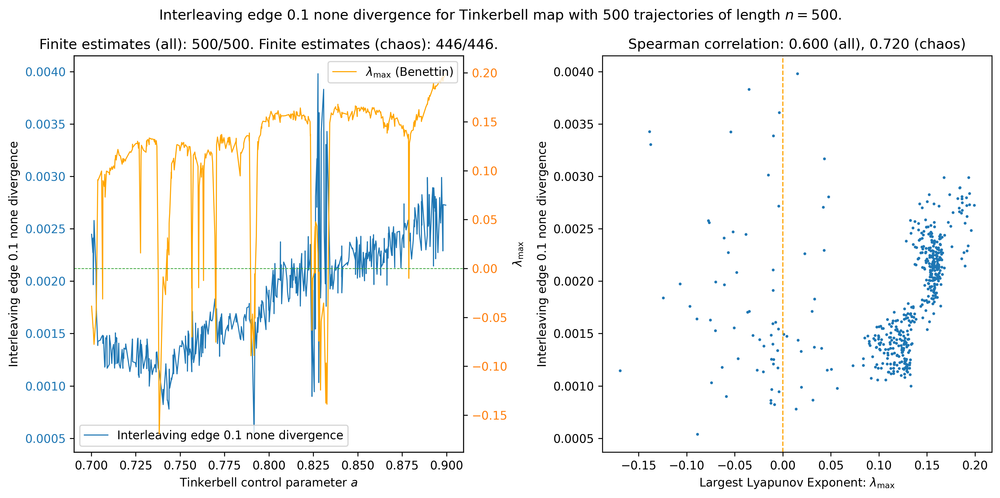

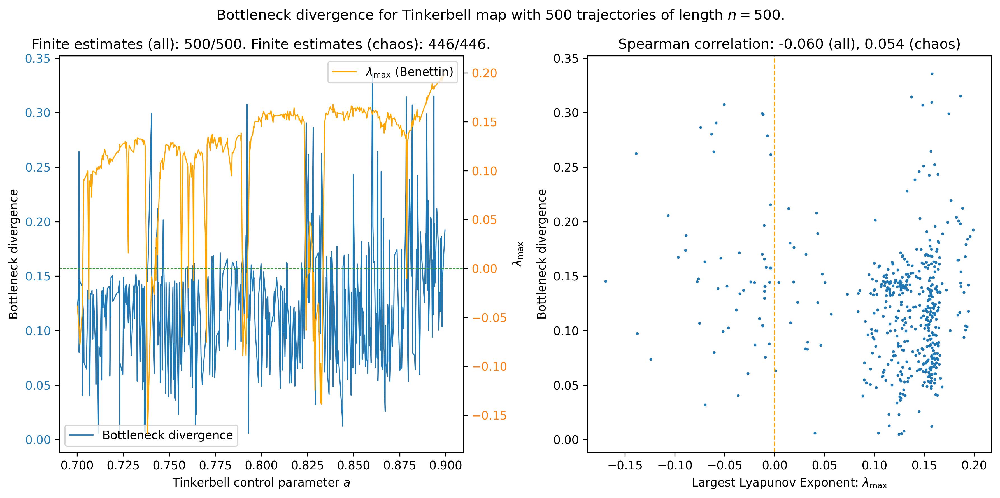

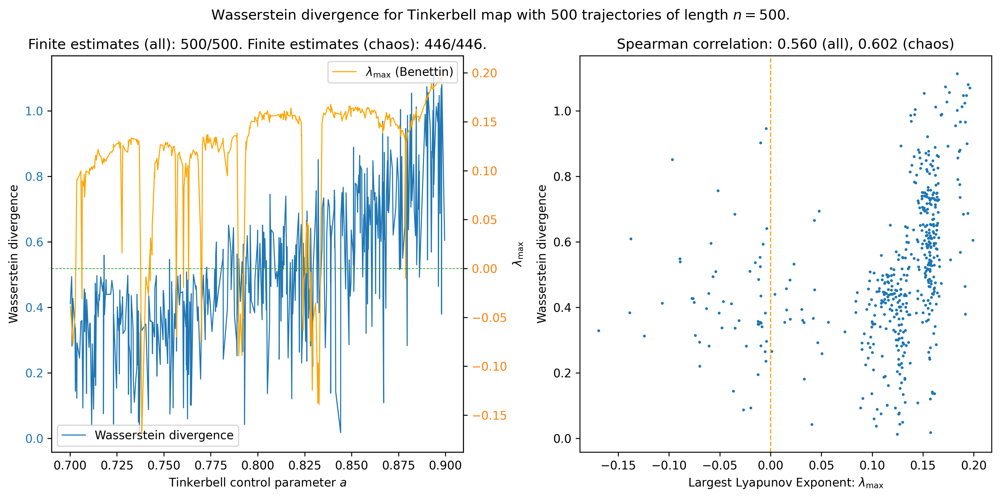

In [73]:
all_results_divergences = generate_correlations_and_scores_from_results_files(
    system_data, SYS_NAMES=SYS_NAMES, DIV_TYPES=DIV_TYPES
)

In [74]:
with open(f"outputs/data/DIVERGENCE_results_{LENGTH}.pkl", "wb") as file:
    pickle.dumps(all_results_divergences)


for result in all_results_divergences:
    print(result, all_results_divergences[result])

('cophenetic divergence', 'henon', 500) {'spearmanr': SpearmanrResult(correlation=0.7364815379261517, pvalue=1.3964935941194425e-86), 'pos_spearmanr': SpearmanrResult(correlation=0.7467992639647886, pvalue=3.699273942702137e-43), 'classification_f1': 0.8544957135005676, 'regression_neg_mean_absolute': -0.283391482667777, 'pos_regression_neg_mean_absolute': -0.531585148377748}
('cophenetic_reverse divergence', 'henon', 500) {'spearmanr': SpearmanrResult(correlation=0.7987872271489085, pvalue=5.628398730614848e-112), 'pos_spearmanr': SpearmanrResult(correlation=0.8319056469435119, pvalue=1.5924061305414393e-61), 'classification_f1': 0.8385343612807358, 'regression_neg_mean_absolute': -0.3598033365287999, 'pos_regression_neg_mean_absolute': -0.5178846464155207}
('interleaving_0.5_None divergence', 'henon', 500) {'spearmanr': SpearmanrResult(correlation=0.7952862851451405, pvalue=2.5524843069588565e-110), 'pos_spearmanr': SpearmanrResult(correlation=0.6062775666453992, pvalue=5.62022251140